
# Image Generation with Imagen on Vertex AI


<table align="left">
  <td style="text-align: center">
    <a href="https://colab.research.google.com/github/GoogleCloudPlatform/generative-ai/blob/main/vision/getting-started/image_generation.ipynb">
      <img src="https://cloud.google.com/ml-engine/images/colab-logo-32px.png" alt="Google Colaboratory logo"><br> Open in Colab
    </a>
  </td>
  <td style="text-align: center">
    <a href="https://console.cloud.google.com/vertex-ai/colab/import/https:%2F%2Fraw.githubusercontent.com%2FGoogleCloudPlatform%2Fgenerative-ai%2Fmain%2Fvision%2Fgetting-started%2Fimage_generation.ipynb">
      <img width="32px" src="https://lh3.googleusercontent.com/JmcxdQi-qOpctIvWKgPtrzZdJJK-J3sWE1RsfjZNwshCFgE_9fULcNpuXYTilIR2hjwN" alt="Google Cloud Colab Enterprise logo"><br> Open in Colab Enterprise
    </a>
  </td>    
  <td style="text-align: center">
    <a href="https://console.cloud.google.com/vertex-ai/workbench/deploy-notebook?download_url=https://raw.githubusercontent.com/GoogleCloudPlatform/generative-ai/main/vision/getting-started/image_generation.ipynb">
      <img src="https://lh3.googleusercontent.com/UiNooY4LUgW_oTvpsNhPpQzsstV5W8F7rYgxgGBD85cWJoLmrOzhVs_ksK_vgx40SHs7jCqkTkCk=e14-rj-sc0xffffff-h130-w32" alt="Vertex AI logo"><br> Open in Workbench
    </a>
  </td>
  <td style="text-align: center">
    <a href="https://github.com/GoogleCloudPlatform/generative-ai/blob/main/vision/getting-started/image_generation.ipynb">
      <img src="https://cloud.google.com/ml-engine/images/github-logo-32px.png" alt="GitHub logo"><br> View on GitHub
    </a>
  </td>
</table>

| | |
|-|-|
|Author(s) | [Thu Ya Kyaw](https://github.com/iamthuya) |

### Costs

- This notebook uses billable components of Google Cloud:
  - Vertex AI (Imagen)

- Learn about [Vertex AI pricing](https://cloud.google.com/vertex-ai/pricing) and use the [Pricing Calculator](https://cloud.google.com/products/calculator/) to generate a cost estimate based on your projected usage.

## Getting Started

### Install Vertex AI SDK for Python

In [ ]:
%pip install --quiet --upgrade --user google-cloud-aiplatform

### Restart current runtime

To use the newly installed packages in this Jupyter runtime, it is recommended to restart the runtime. Run the following cell to restart the current kernel.

The restart process might take a minute or so.

In [ ]:
import IPython

app = IPython.Application.instance()
app.kernel.do_shutdown(True)

After the restart is complete, continue to the next step.


<div class="alert alert-block alert-warning">
<b>⚠️ The kernel is going to restart. Please wait until it is finished before continuing to the next step. ⚠️</b>
</div>

### Authenticate your notebook environment (Colab only)

If you are running this notebook on Google Colab, run the following cell to authenticate your environment. This step is not required if you are using [Vertex AI Workbench](https://cloud.google.com/vertex-ai-workbench).

In [ ]:
import sys

# Additional authentication is required for Google Colab
if "google.colab" in sys.modules:
    # Authenticate user to Google Cloud
    from google.colab import auth

    auth.authenticate_user()

### Define Google Cloud project information and initialize Vertex AI

Initialize the Vertex AI SDK for Python for your project:

In [15]:
# Define project information
PROJECT_ID = "octopus-193701"  # @param {type:"string"}
LOCATION = "us-central1"  # @param {type:"string"}

# Initialize Vertex AI
import vertexai

vertexai.init(project=PROJECT_ID, location=LOCATION)

### Load the image generation model

The model names from Vertex AI Imagen have two components: model name and version number. The naming convention follow this format: `<model-name>@<version-number>`. For example, `imagegeneration@001` represents the version **001** of the **imagegeneration** model.


In [ ]:
from vertexai.preview.vision_models import ImageGenerationModel

generation_model = ImageGenerationModel.from_pretrained("imagegeneration@006")

### Generate an image

The `generate_image` function can be used to generate images. All you need is a text prompt.

In [ ]:
prompt = "aerial shot of a river flowing up a mystical valley"

response = generation_model.generate_images(
    prompt=prompt,
)

response.images[0].show()

Now, you have the power to generate the image you desire. Here are some example prompts to inspire you:
- A raccoon wearing formal clothes, wearing a top hat. Oil painting in the style of Vincent Van Gogh.
- A digital collage of famous works of art, all blended together into one cohesive image.
- A whimsical scene from a children's book, such as a tea party with talking animals.
- A futuristic cityscape with towering skyscrapers and flying cars.
- A studio photo of a modern armchair, dramatic lighting, warm.
- A surreal landscape of a city made of ice and snow.

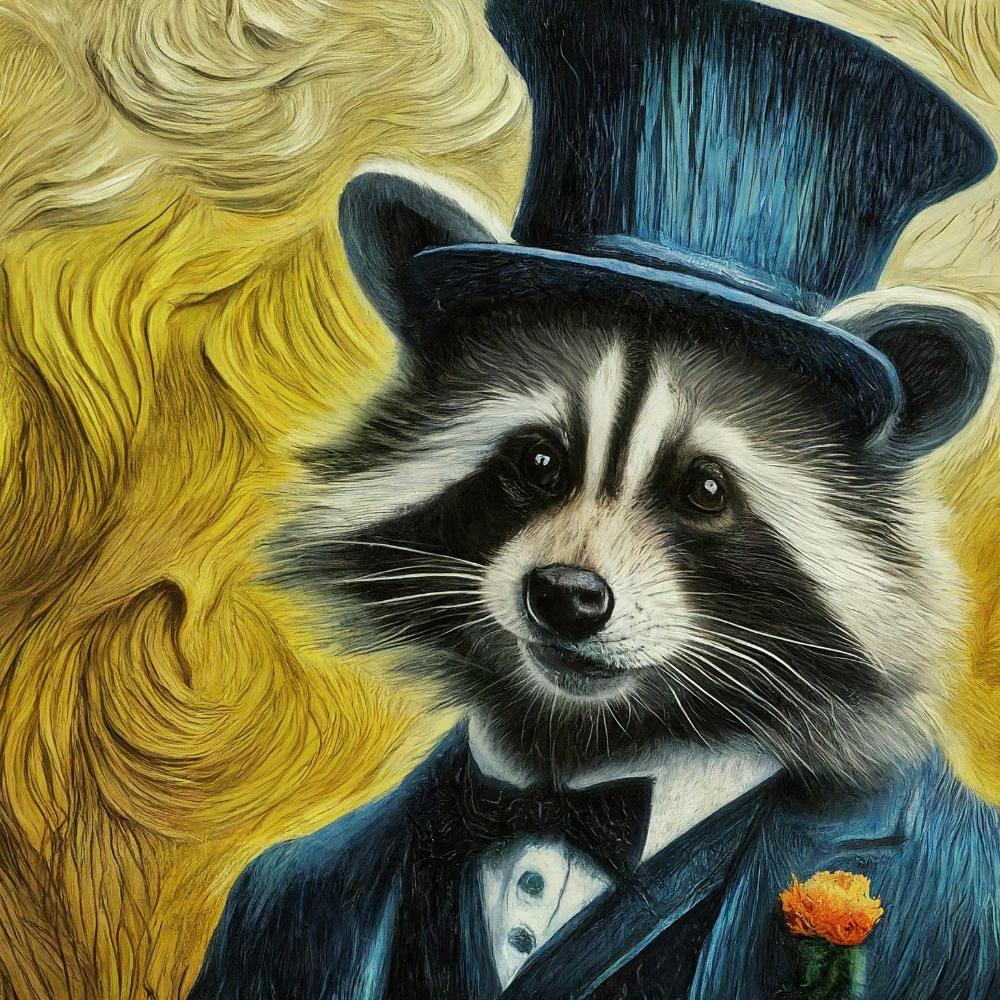

In [ ]:
prompt = "A raccoon wearing formal clothes, wearing a top hat. Oil painting in the style of Vincent Van Gogh."  # @param {type:"string"}

response = generation_model.generate_images(prompt=prompt)

response.images[0].show()

In [ ]:
prompt = "aerial shot of a river flowing up a mystical valley"

response = generation_model.generate_images(
    prompt=prompt,
)

response.images[0].show()

# My Images

Generating sun


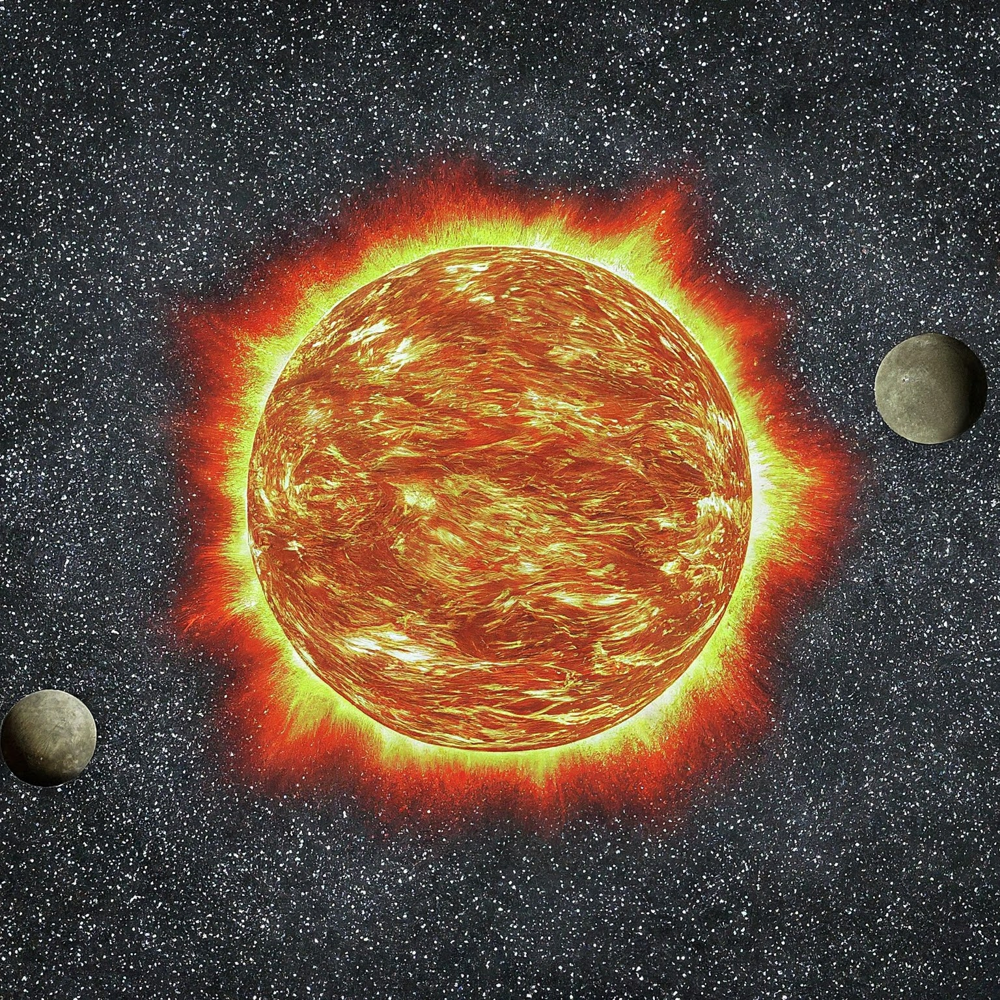

Generating mercury


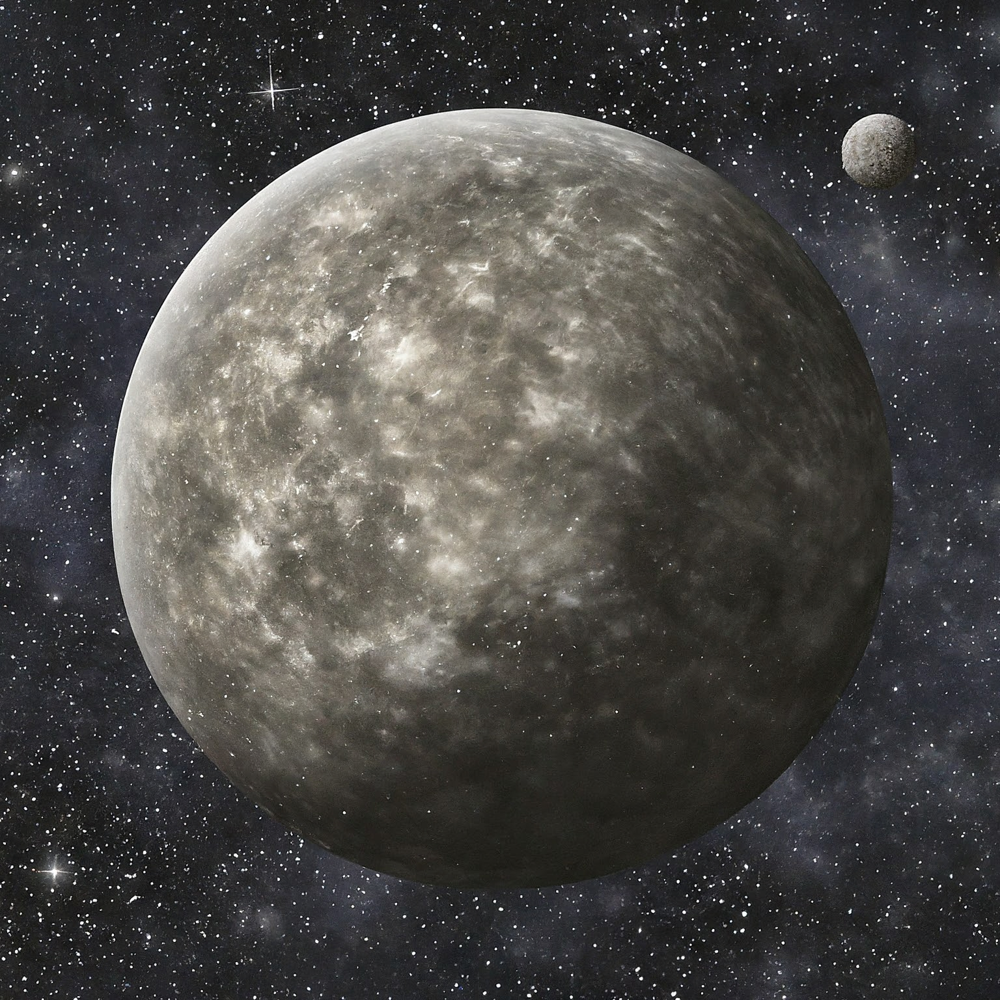

Generating saturn


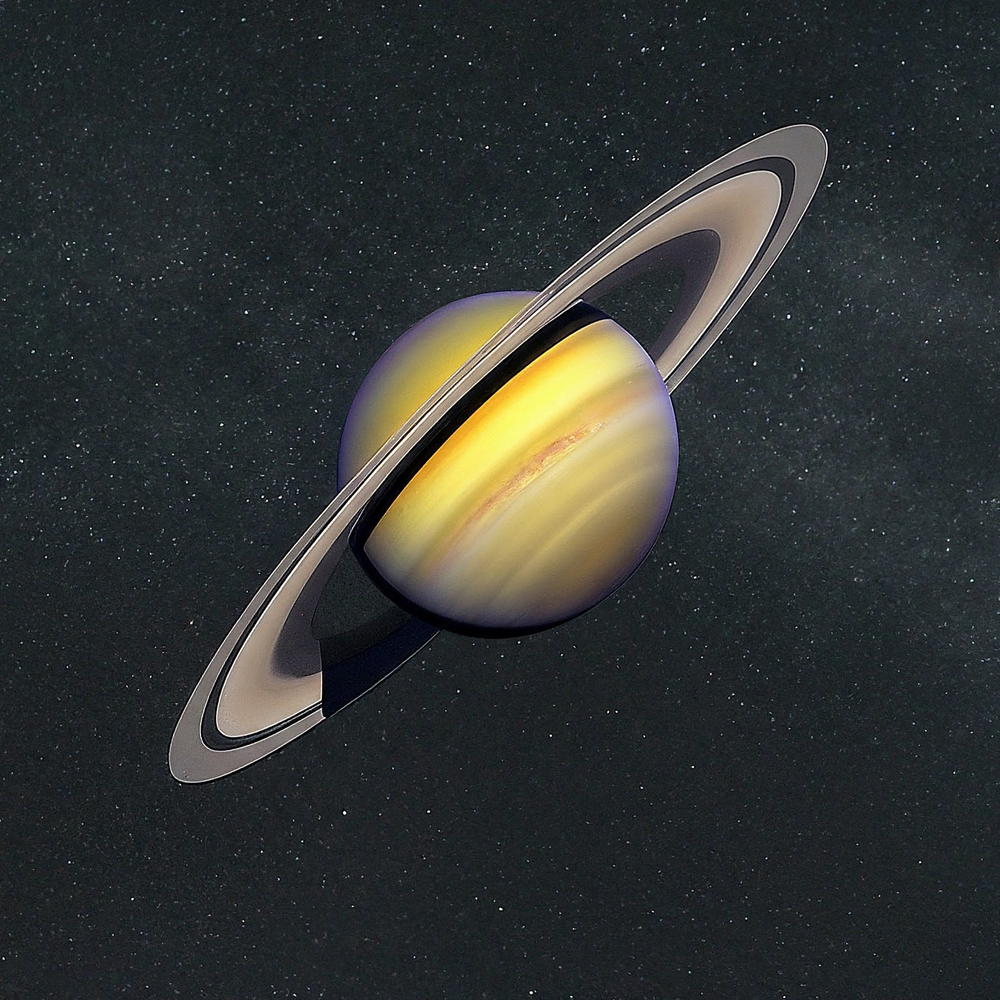

Generating neptune


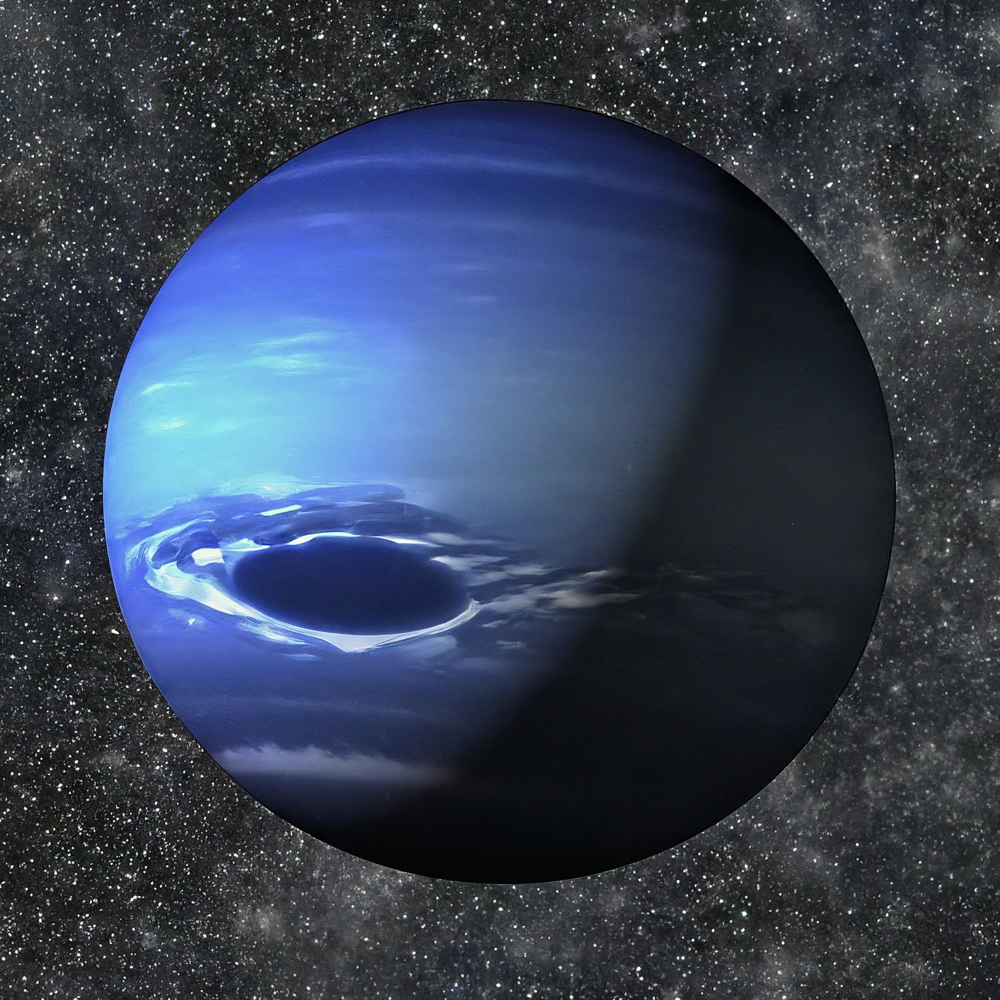

In [33]:
planets = "sun mercury venus earth mars jupiter saturn uranus neptune".split()
planets = "sun mercury saturn neptune".split()

results = {}

for planet in planets:
  print(f"Generating {planet}")
  results[planet] = generation_model.generate_images(
      prompt=f"""
      fantastic rendering of {planet} on a solid dark background with stars.
      Emphasize the rings and moons of the planet if it has any
      """,
      aspect_ratio = "1:1",
  ).images[0]
  results[planet].show()
  results[planet].save(f"{planet}.jpg")

